In [2]:
import pandas as pd
import numpy as np
import datetime
import warnings

warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", message="numpy.ufunc size changed")

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

pd.set_option('display.max_columns', None)

In [3]:
customer_df = pd.read_csv('we_fn_use_c_marketing_customer_value_analysis.csv')
customer_df

,Customer,State,Customer Lifetime Value,Response,Coverage,Education,Effective To Date,EmploymentStatus,Gender,Income,Location Code,Marital Status,Monthly Premium Auto,Months Since Last Claim,Months Since Policy Inception,Number of Open Complaints,Number of Policies,Policy Type,Policy,Renew Offer Type,Sales Channel,Total Claim Amount,Vehicle Class,Vehicle Size
0,BU79786,Washington,2763.519279,No,Basic,Bachelor,2/24/11,Employed,F,56274,Suburban,Married,69,32,5,0,1,Corporate Auto,Corporate L3,Offer1,Agent,384.811147,Two-Door Car,Medsize
1,QZ44356,Arizona,6979.535903,No,Extended,Bachelor,1/31/11,Unemployed,F,0,Suburban,Single,94,13,42,0,8,Personal Auto,Personal L3,Offer3,Agent,1131.464935,Four-Door Car,Medsize
2,AI49188,Nevada,12887.431650,No,Premium,Bachelor,2/19/11,Employed,F,48767,Suburban,Married,108,18,38,0,2,Personal Auto,Personal L3,Offer1,Agent,566.472247,Two-Door Car,Medsize
3,WW63253,California,7645.861827,No,Basic,Bachelor,1/20/11,Unemployed,M,0,Suburban,Married,106,18,65,0,7,Corporate Auto,Corporate L2,Offer1,Call Center,529.881344,SUV,Medsize
4,HB64268,Washington,2813.692575,No,Basic,Bachelor,2/3/11,Employed,M,43836,Rural,Single,73,12,44,0,1,Personal Auto,Personal L1,Offer1,Agent,138.130879,Four-Door Car,Medsize
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9129,LA72316,California,23405.987980,No,Basic,Bachelor,2/10/11,Employed,M,71941,Urban,Married,73,18,89,0,2,Personal Auto,Personal L1,Offer2,Web,198.234764,Four-Door Car,Medsize
9130,PK87824,California,3096.511217,Yes,Extended,College,2/12/11,Employed,F,21604,Suburban,Divorced,79,14,28,0,1,Corporate Auto,Corporate L3,Offer1,Branch,379.200000,Four-Door Car,Medsize
9131,TD14365,California,8163.890428,No,Extended,Bachelor,2/6/11,Unemployed,M,0,Suburban,Single,85,9,37,3,2,Corporate Auto,Corporate L2,Offer1,Branch,790.784983,Four-Door Car,Medsize
9132,UP19263,California,7524.442436,No,Extended,College,2/3/11,Employed,M,21941,Suburban,Married,96,34,3,0,3,Personal Auto,Personal L2,Offer3,Branch,691.200000,Four-Door Car,Large


In [4]:
customer_df.isna().sum()

Customer                         0
State                            0
Customer Lifetime Value          0
Response                         0
Coverage                         0
Education                        0
Effective To Date                0
EmploymentStatus                 0
Gender                           0
Income                           0
Location Code                    0
Marital Status                   0
Monthly Premium Auto             0
Months Since Last Claim          0
Months Since Policy Inception    0
Number of Open Complaints        0
Number of Policies               0
Policy Type                      0
Policy                           0
Renew Offer Type                 0
Sales Channel                    0
Total Claim Amount               0
Vehicle Class                    0
Vehicle Size                     0
dtype: int64

In [5]:
customer_df.columns

Index(['Customer', 'State', 'Customer Lifetime Value', 'Response', 'Coverage',
       'Education', 'Effective To Date', 'EmploymentStatus', 'Gender',
       'Income', 'Location Code', 'Marital Status', 'Monthly Premium Auto',
       'Months Since Last Claim', 'Months Since Policy Inception',
       'Number of Open Complaints', 'Number of Policies', 'Policy Type',
       'Policy', 'Renew Offer Type', 'Sales Channel', 'Total Claim Amount',
       'Vehicle Class', 'Vehicle Size'],
      dtype='object')

In [6]:
column_mapping = {col: col.lower().replace(' ', '_') for col in customer_df.columns}
customer_df.rename(columns=column_mapping, inplace=True)


In [7]:
customer_df.columns

Index(['customer', 'state', 'customer_lifetime_value', 'response', 'coverage',
       'education', 'effective_to_date', 'employmentstatus', 'gender',
       'income', 'location_code', 'marital_status', 'monthly_premium_auto',
       'months_since_last_claim', 'months_since_policy_inception',
       'number_of_open_complaints', 'number_of_policies', 'policy_type',
       'policy', 'renew_offer_type', 'sales_channel', 'total_claim_amount',
       'vehicle_class', 'vehicle_size'],
      dtype='object')

In [8]:
customer_df = customer_df.drop('customer', axis=1)

In [9]:
customer_df.transpose()

0              1              2     \
state                              Washington        Arizona         Nevada   
customer_lifetime_value           2763.519279    6979.535903    12887.43165   
response                                   No             No             No   
coverage                                Basic       Extended        Premium   
education                            Bachelor       Bachelor       Bachelor   
effective_to_date                     2/24/11        1/31/11        2/19/11   
employmentstatus                     Employed     Unemployed       Employed   
gender                                      F              F              F   
income                                  56274              0          48767   
location_code                        Suburban       Suburban       Suburban   
marital_status                        Married         Single        Married   
monthly_premium_auto                       69             94            108   
months_since_last_claim                    32             13             18   
months_since_policy_inception               5             42             38   
number_of_open_complaints                   0              0              0   
number_of_policies                          1              8              2   
policy_type                    Corporate Auto  Personal Auto  Personal Auto   
policy                           Corporate L3    Personal L3    Personal L3   
renew_offer_type                       Offer1         Offer3         Offer1   
sales_channel                           Agent          Agent          Agent   
total_claim_amount                 384.811147    1131.464935     566.472247   
vehicle_class                    Two-Door Car  Four-Door Car   Two-Door Car   
vehicle_size                          Medsize        Medsize        Medsize   

                                         3              4              5     \
state                              California     Washington         Oregon   
customer_lifetime_value           7645.861827    2813.692575      8256.2978   
response                                   No             No            Yes   
coverage                                Basic          Basic          Basic   
education                            Bachelor       Bachelor       Bachelor   
effective_to_date                     1/20/11         2/3/11        1/25/11   
employmentstatus                   Unemployed       Employed       Employed   
gender                                      M              M              F   
income                                      0          43836          62902   
location_code                        Suburban          Rural          Rural   
marital_status                        Married         Single        Married   
monthly_premium_auto                      106             73             69   
months_since_last_claim                    18             12             14   
months_since_policy_inception              65             44             94   
number_of_open_complaints                   0              0              0   
number_of_policies                          7              1              2   
policy_type                    Corporate Auto  Personal Auto  Personal Auto   
policy                           Corporate L2    Personal L1    Personal L3   
renew_offer_type                       Offer1         Offer1         Offer2   
sales_channel                     Call Center          Agent            Web   
total_claim_amount                 529.881344     138.130879     159.383042   
vehicle_class                             SUV  Four-Door Car   Two-Door Car   
vehicle_size                          Medsize        Medsize        Medsize   

                                         6               7               8     \
state                                  Oregon         Arizona          Oregon   
customer_lifetime_value           5380.898636     7216.100311     24127.50402   
resp

In [10]:
customer_df['number_of_open_complaints'] = customer_df['number_of_open_complaints'].astype('object')

# Convert 'Number of Policies' to categorical
customer_df['number_of_policies'] = customer_df['number_of_policies'].astype('object')

In [11]:
categorical_df = customer_df.select_dtypes(include='object')

In [12]:
numerical_df = customer_df.select_dtypes(include=['float64', 'int64'])


In [13]:
categorical_df.transpose()

0              1              2     \
state                          Washington        Arizona         Nevada   
response                               No             No             No   
coverage                            Basic       Extended        Premium   
education                        Bachelor       Bachelor       Bachelor   
effective_to_date                 2/24/11        1/31/11        2/19/11   
employmentstatus                 Employed     Unemployed       Employed   
gender                                  F              F              F   
location_code                    Suburban       Suburban       Suburban   
marital_status                    Married         Single        Married   
number_of_open_complaints               0              0              0   
number_of_policies                      1              8              2   
policy_type                Corporate Auto  Personal Auto  Personal Auto   
policy                       Corporate L3    Personal L3    Personal L3   
renew_offer_type                   Offer1         Offer3         Offer1   
sales_channel                       Agent          Agent          Agent   
vehicle_class                Two-Door Car  Four-Door Car   Two-Door Car   
vehicle_size                      Medsize        Medsize        Medsize   

                                     3              4              5     \
state                          California     Washington         Oregon   
response                               No             No            Yes   
coverage                            Basic          Basic          Basic   
education                        Bachelor       Bachelor       Bachelor   
effective_to_date                 1/20/11         2/3/11        1/25/11   
employmentstatus               Unemployed       Employed       Employed   
gender                                  M              M              F   
location_code                    Suburban          Rural          Rural   
marital_status                    Married         Single        Married   
number_of_open_complaints               0              0              0   
number_of_policies                      7              1              2   
policy_type                Corporate Auto  Personal Auto  Personal Auto   
policy                       Corporate L2    Personal L1    Personal L3   
renew_offer_type                   Offer1         Offer1         Offer2   
sales_channel                 Call Center          Agent            Web   
vehicle_class                         SUV  Four-Door Car   Two-Door Car   
vehicle_size                      Medsize        Medsize        Medsize   

                                     6               7               8     \
state                              Oregon         Arizona          Oregon   
response                              Yes              No             Yes   
coverage                            Basic         Premium           Basic   
education                         College          Master        Bachelor   
effective_to_date                 2/24/11         1/18/11         1/26/11   
employmentstatus                 Employed      Unemployed   Medical Leave   
gender                                  F               M               M   
location_code                    Suburban           Urban        Suburban   
marital_status                    Married          Single        Divorced   
number_of_open_complaints               0               0               0   
number_of_policies                      9               4               2   
policy_type                Corporate Auto  Corporate Auto  Corporate Auto   
policy                       Corporate L3    Corporate L3    Corporate L3   
renew_offer_type                   Offer1          Offer1          Offer1   
sales_channel                       Agent           Agent           Agent   
vehicle_class               Four-Door Car   Four-Door Car   Four-Door Car   
vehicle_size              

In [14]:
numerical_df.transpose()

0            1             2     \
customer_lifetime_value         2763.519279  6979.535903  12887.431650   
income                         56274.000000     0.000000  48767.000000   
monthly_premium_auto              69.000000    94.000000    108.000000   
months_since_last_claim           32.000000    13.000000     18.000000   
months_since_policy_inception      5.000000    42.000000     38.000000   
total_claim_amount               384.811147  1131.464935    566.472247   

                                      3             4             5     \
customer_lifetime_value        7645.861827   2813.692575   8256.297800   
income                            0.000000  43836.000000  62902.000000   
monthly_premium_auto            106.000000     73.000000     69.000000   
months_since_last_claim          18.000000     12.000000     14.000000   
months_since_policy_inception    65.000000     44.000000     94.000000   
total_claim_amount              529.881344    138.130879    159.383042   

                                       6            7            8     \
customer_lifetime_value         5380.898636  7216.100311  24127.50402   
income                         55350.000000     0.000000  14072.00000   
monthly_premium_auto              67.000000   101.000000     71.00000   
months_since_last_claim            0.000000     0.000000     13.00000   
months_since_policy_inception     13.000000    68.000000      3.00000   
total_claim_amount               321.600000   363.029680    511.20000   

                                       9            10           11    \
customer_lifetime_value         7388.178085  4738.992022  8197.197078   
income                         28812.000000     0.000000     0.000000   
monthly_premium_auto              93.000000    67.000000   110.000000   
months_since_last_claim           17.000000    23.000000    27.000000   
months_since_policy_inception      7.000000     5.000000    87.000000   
total_claim_amount               425.527834   482.400000   528.000000   

                                       12            13            14    \
customer_lifetime_value         8798.797003   8819.018934   5384.431665   
income                         77026.000000  99845.000000  83689.000000   
monthly_premium_auto             110.000000    110.000000     70.000000   
months_since_last_claim            9.000000     23.000000     21.000000   
months_since_policy_inception     82.000000     25.000000     10.000000   
total_claim_amount               472.029737    528.000000    307.139132   

                                       15            16            17    \
customer_lifetime_value         7463.139377   2566.867823   3945.241604   
income                         24599.000000  25049.000000  28855.000000   
monthly_premium_auto              64.000000     67.000000    101.000000   
months_since_last_claim           12.000000     14.000000     12.000000   
months_since_policy_inception     50.000000      7.000000     59.000000   
total_claim_amount                42.920271    454.245098    647.442031   

                                       18            19            20    \
customer_lifetime_value         5710.333115   8162.617053   2872.051273   
income                         51148.000000  66140.000000  57749.000000   
monthly_premium_auto              72.000000    101.000000     74.000000   
months_since_last_claim            9.000000     11.000000     31.000000   
months_since_policy_inception      1.000000     21.000000     21.000000   
total_claim_amount               308.981664    484.800000    355.200000   

                                       21           22           23    \
customer_lifetime_value         3041.791561  24127.50402  2450.190996   
income                         13789.000000  14072.00000     0.000000   
monthly_premium_auto              79.000000     71.00000    73.000000   
months_since_last_claim            8.000000     13.00000     4.000000   
months_since_policy_inception     

In [16]:
categorical_df.columns

Index(['state', 'response', 'coverage', 'education', 'effective_to_date',
       'employmentstatus', 'gender', 'location_code', 'marital_status',
       'number_of_open_complaints', 'number_of_policies', 'policy_type',
       'policy', 'renew_offer_type', 'sales_channel', 'vehicle_class',
       'vehicle_size'],
      dtype='object')

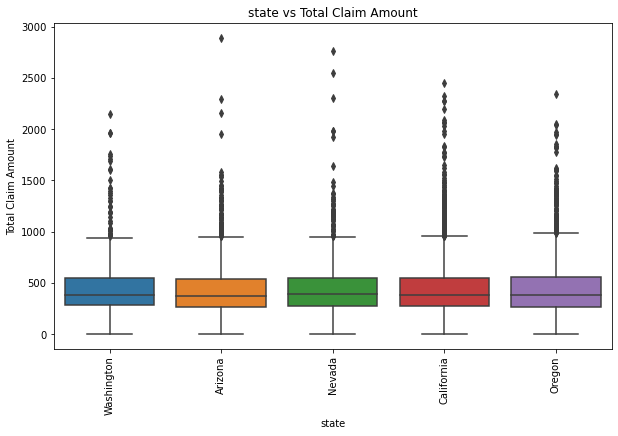

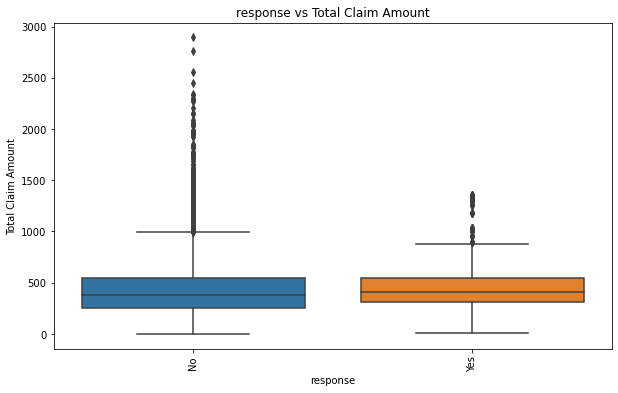

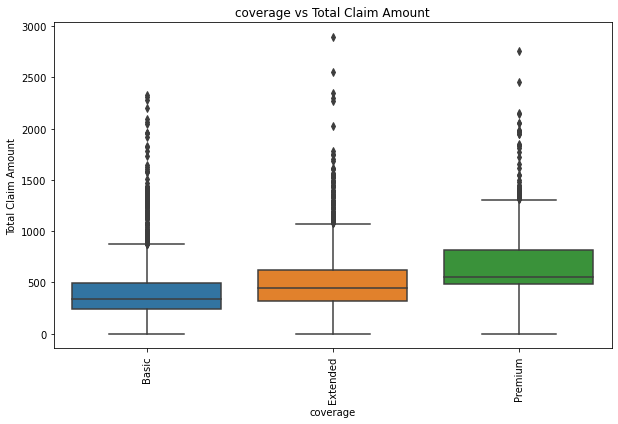

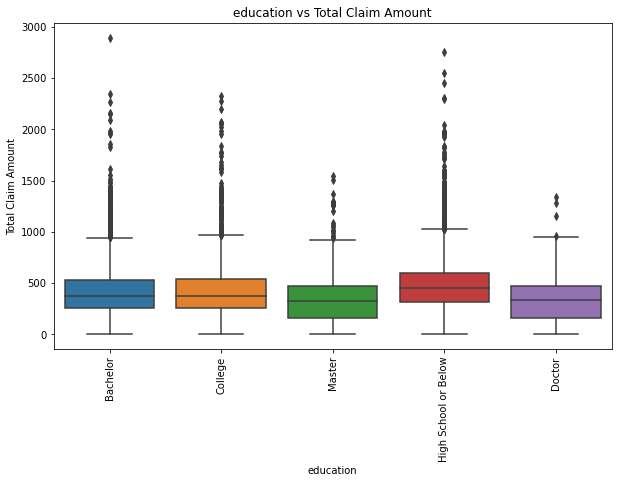

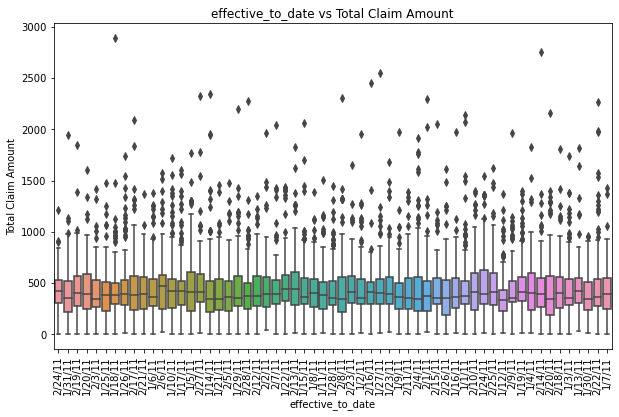

...

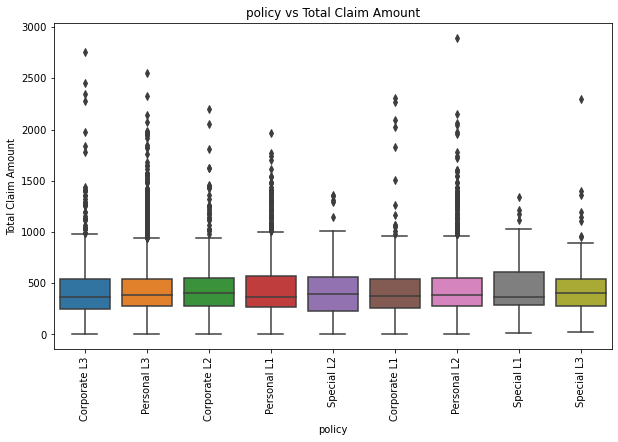

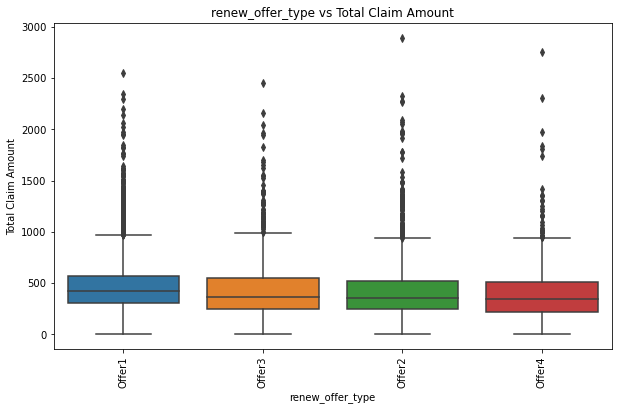

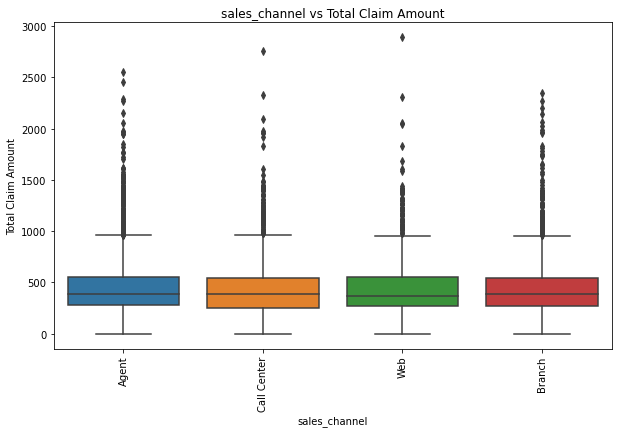

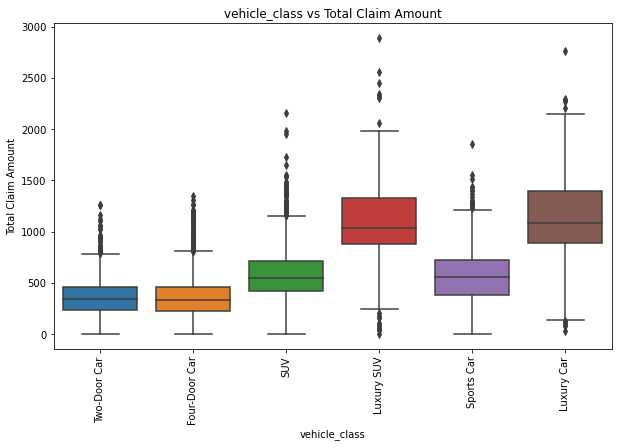

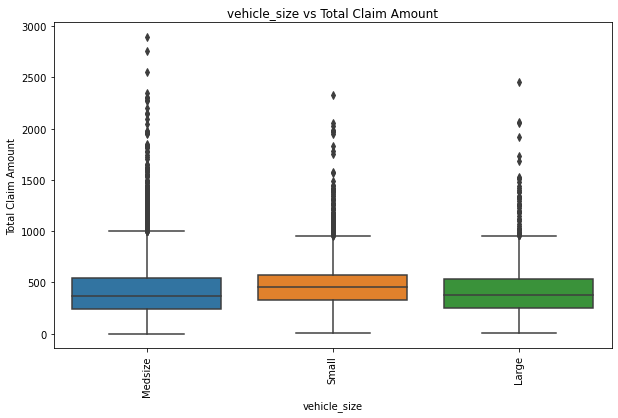

In [20]:
for column in categorical_df.columns:
    if column != 'total_claim_amount':
        plt.figure(figsize=(10, 6))
        merged_df = pd.concat([categorical_df[column], numerical_df['total_claim_amount']], axis=1)
        sns.boxplot(x=column, y='total_claim_amount', data=merged_df)
        plt.title(f"{column} vs Total Claim Amount")
        plt.xlabel(column)
        plt.ylabel("Total Claim Amount")
        plt.xticks(rotation=90)
        plt.show()

In [21]:
for column in categorical_df.columns:
    print(f"Value counts for column '{column}':")
    print(categorical_df[column].value_counts())
    print()

Value counts for column 'state':
California    3150
Oregon        2601
Arizona       1703
Nevada         882
Washington     798
Name: state, dtype: int64

Value counts for column 'response':
No     7826
Yes    1308
Name: response, dtype: int64

Value counts for column 'coverage':
Basic       5568
Extended    2742
Premium      824
Name: coverage, dtype: int64

Value counts for column 'education':
Bachelor                2748
College                 2681
High School or Below    2622
Master                   741
Doctor                   342
Name: education, dtype: int64

Value counts for column 'effective_to_date':
1/10/11    195
1/27/11    194
2/14/11    186
1/26/11    181
1/17/11    180
1/19/11    179
1/31/11    178
1/3/11     178
1/20/11    173
2/26/11    169
1/28/11    169
2/19/11    168
1/5/11     167
2/27/11    167
1/11/11    166
2/4/11     164
2/10/11    161
2/28/11    161
1/2/11     160
1/21/11    160
1/29/11    160
2/22/11    158
2/5/11     158
2/3/11     158
2/7/11     157
2/12/